In [6]:
import os
import torch
from torch import nn
from torch.nn import functional as F
from torch import optim
from torch.utils.data import DataLoader, sampler
from torchvision import transforms as T
from torchvision import models

from PIL import Image

from matplotlib import pyplot as plt
%matplotlib inline

from datetime import datetime

from usns_v2 import *

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
DATA_PATH = 'data/'
MODEL_PATH = 'models/'
SUBMS_PATH = 'submissions/'


if torch.cuda.is_available():
    device = torch.device('cuda')
    dtype = torch.cuda.FloatTensor
else:
    device = torch.device('cpu')
    dtype = torch.FloatTensor

In [4]:
params = {
    'batch_size': 16,
    'num_train': 2000,
    'num_train_full': 5000
}

In [5]:
trainset = USNSDataset(os.path.join(DATA_PATH, 'labeled'), train=True, transform=transform, mask_transform=transform_mask)

loader_train = DataLoader(trainset, batch_size=params['batch_size'],
                          sampler=sampler.SubsetRandomSampler(range(params['num_train'])),
                          num_workers=4, pin_memory=True)
loader_val = DataLoader(trainset, batch_size=params['batch_size'],
                        sampler=sampler.SubsetRandomSampler(range(params['num_train'], trainset.__len__())),
                        num_workers=4, pin_memory=True)

trainset_full = USNSDataset(os.path.join(DATA_PATH, 'train'), train=True,
                            transform=transform, mask_transform=transform_mask)
loader_train_full = DataLoader(trainset_full, batch_size=params['batch_size'],
                               sampler=sampler.SubsetRandomSampler(range(params['num_train_full'])),
                               num_workers=4, pin_memory=True)
loader_val_full = DataLoader(trainset_full, batch_size=params['batch_size'],
                             sampler=sampler.SubsetRandomSampler(range(params['num_train_full'], len(trainset_full))),
                             num_workers=4, pin_memory=True)

In [6]:
n_filters = 4

unet = Unet(n_filters=n_filters, bn=True)
unet = unet.to(device=device);

binoutnet = BinaryNetSimple(n_filters)
binoutnet = binoutnet.to(device=device)

detector = USNSDetector(unet, binoutnet, device)

1008 images processed, loss = 0.4239619675021557
Validation loss = 0.42839079333942737
Dice score = 0.21519835381294136

2000 images processed, loss = 0.4139117203135432
Validation loss = 0.40657796293140547
Dice score = 0.2094317212657795

3008 images processed, loss = 0.4092677830948574
Validation loss = 0.4117817982003738
Dice score = 0.1972472446356525

4000 images processed, loss = 0.39186059080840663
Validation loss = 0.36974669493077683
Dice score = 0.39918425276303693

5000 images processed, loss = 0.3851726052215435
Validation loss = 0.36742636775180665
Dice score = 0.29379879295542766

After 1 epochs: loss = 0.0
Validation loss = 0.3674263678022151
Dice score = 0.29379879295542766


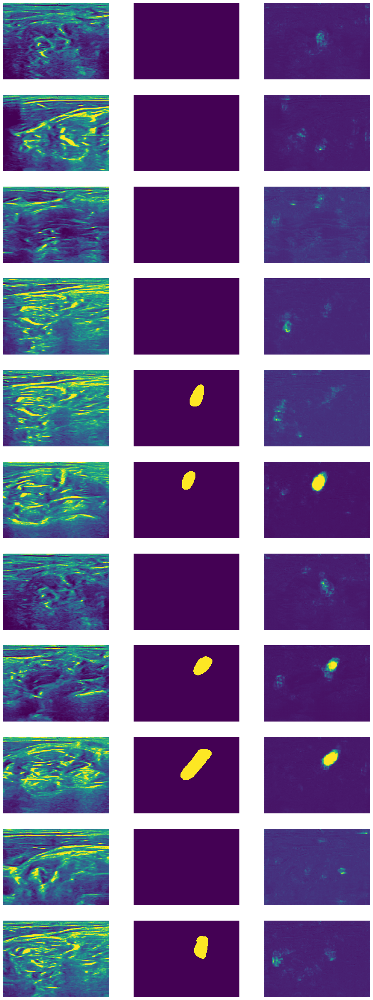


6008 images processed, loss = 0.3705986775323248
Validation loss = 0.3639128176313467
Dice score = 0.37550539025376767

7000 images processed, loss = 0.3599985758954266
Validation loss = 0.3821113004876424
Dice score = 0.3009824864734933

8008 images processed, loss = 0.3539443957251894
Validation loss = 0.35926155600612614
Dice score = 0.3780461598883279

9000 images processed, loss = 0.35251172874298053
Validation loss = 0.3444809663656747
Dice score = 0.35815691280410367

10000 images processed, loss = 0.3384655784756205
Validation loss = 0.3372836823675364
Dice score = 0.39140282546439153

After 2 epochs: loss = 0.0
Validation loss = 0.3372836824250157
Dice score = 0.3914028254643915


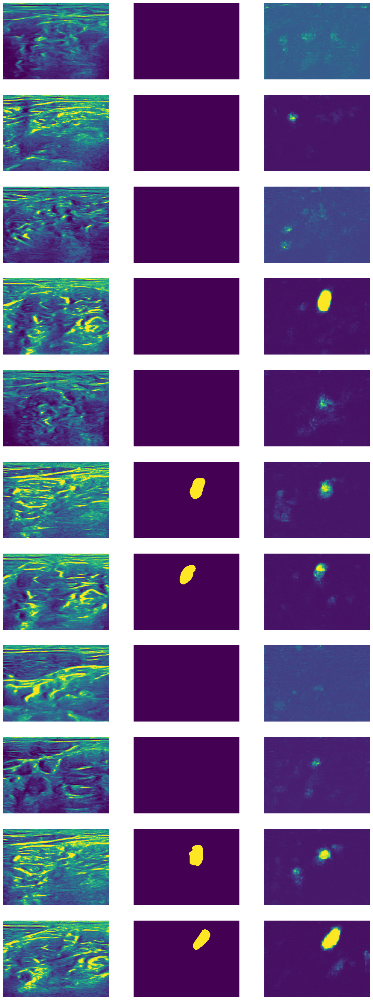


11008 images processed, loss = 0.33142109501629813
Validation loss = 0.33886720942057896
Dice score = 0.36245768102925546

12000 images processed, loss = 0.3206586841322779
Validation loss = 0.3254264923984147
Dice score = 0.266769544940654

13008 images processed, loss = 0.3140055881655613
Validation loss = 0.3076581521744284
Dice score = 0.41611907824118416

14000 images processed, loss = 0.31112129127562715
Validation loss = 0.3050134823799705
Dice score = 0.4720472076758104

15000 images processed, loss = 0.301482838250302
Validation loss = 0.3000959778563719
Dice score = 0.3594482401951894

After 3 epochs: loss = 0.0
Validation loss = 0.3000959780368635
Dice score = 0.3594482401951894


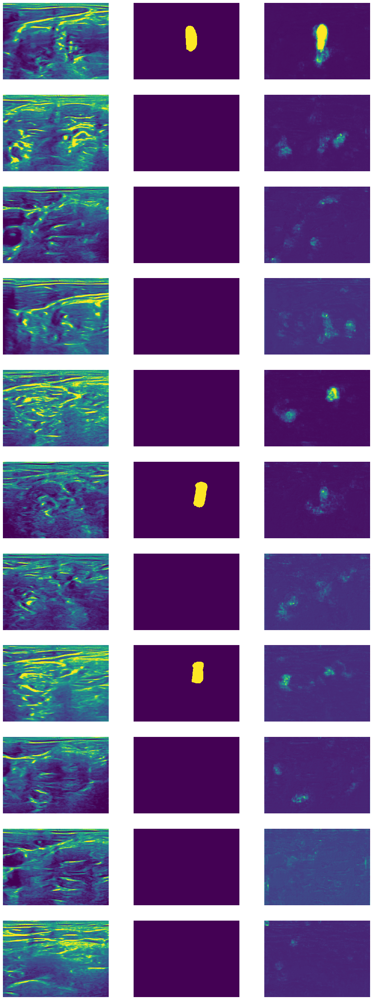


16008 images processed, loss = 0.28797650290092025
Validation loss = 0.3119467223143829
Dice score = 0.3522857432712122

17000 images processed, loss = 0.27972231581894386
Validation loss = 0.3278310076450442
Dice score = 0.26418719828735854

18008 images processed, loss = 0.277290323509613
Validation loss = 0.2805206632945899
Dice score = 0.4201650104861692

19000 images processed, loss = 0.2678439971946412
Validation loss = 0.3041130444595141
Dice score = 0.39397794994762425

20000 images processed, loss = 0.27231068773250844
Validation loss = 0.28356762312611605
Dice score = 0.3273184152801849

After 4 epochs: loss = 0.0
Validation loss = 0.2835676230697957
Dice score = 0.327318415280185


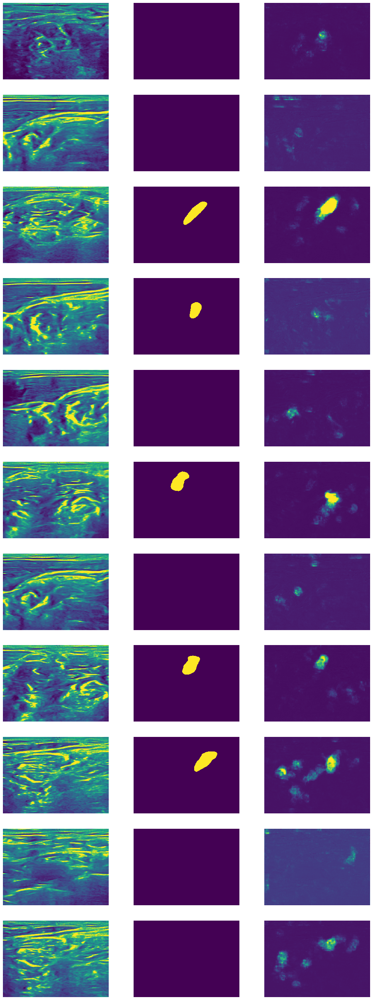


21008 images processed, loss = 0.26757514426992113
Validation loss = 0.26115362946326054
Dice score = 0.48665368762334915

22000 images processed, loss = 0.2547300063844814
Validation loss = 0.2560670196976824
Dice score = 0.43121626037154615

23008 images processed, loss = 0.24280752295974467
Validation loss = 0.2393133828244686
Dice score = 0.4876259742187648

24000 images processed, loss = 0.2456944498598005
Validation loss = 0.2710635951848423
Dice score = 0.31733751939669336

25000 images processed, loss = 0.23228186125327563
Validation loss = 0.23732457998168652
Dice score = 0.48910880072543805

After 5 epochs: loss = 0.0
Validation loss = 0.23732458029820172
Dice score = 0.4891088007254382


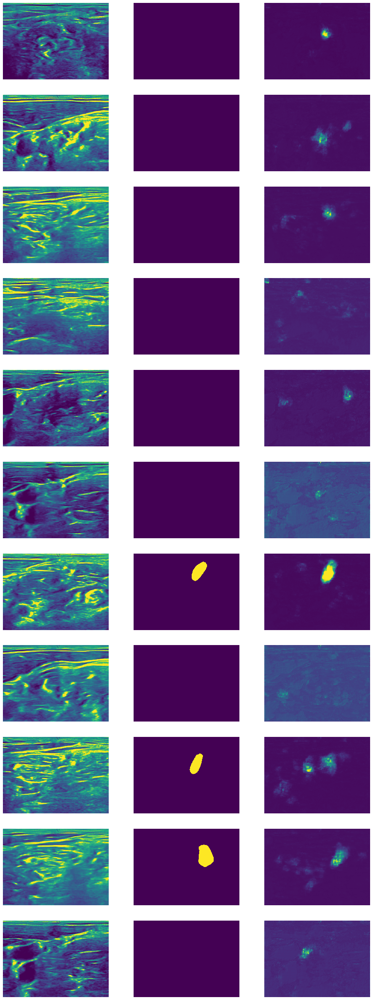


26008 images processed, loss = 0.223706057642175
Validation loss = 0.24000662501853667
Dice score = 0.4075611816461334

27000 images processed, loss = 0.219245905031729
Validation loss = 0.22044336150747126
Dice score = 0.5155433992165618

28008 images processed, loss = 0.21660631215421836
Validation loss = 0.242864583417078
Dice score = 0.3826170984960068

29000 images processed, loss = 0.20869434093062394
Validation loss = 0.2220503838101341
Dice score = 0.42772161698040256

30000 images processed, loss = 0.2134939301390825
Validation loss = 0.25117693575691946
Dice score = 0.32828099708927155

After 6 epochs: loss = 0.0
Validation loss = 0.2511769365172583
Dice score = 0.3282809970892717


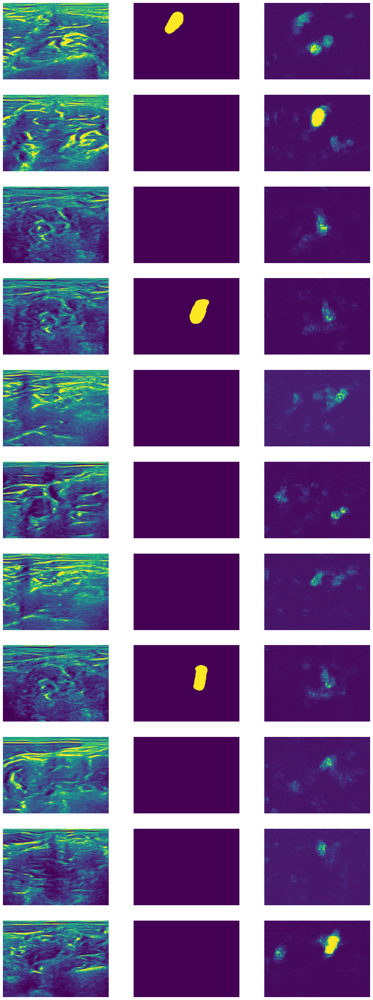


31008 images processed, loss = 0.1961746834148999
Validation loss = 0.20640177389861275
Dice score = 0.5100362393413304

32000 images processed, loss = 0.18963676347598393
Validation loss = 0.21317682526310747
Dice score = 0.45300716836587634

33008 images processed, loss = 0.19127394515327265
Validation loss = 0.2092339172582393
Dice score = 0.4975711045726586

34000 images processed, loss = 0.19002047221422896
Validation loss = 0.209652143841029
Dice score = 0.3924146701992419

35000 images processed, loss = 0.1852592080653866
Validation loss = 0.20463424681603146
Dice score = 0.47763610842642645

After 7 epochs: loss = 0.0
Validation loss = 0.20463424664651028
Dice score = 0.4776361084264265


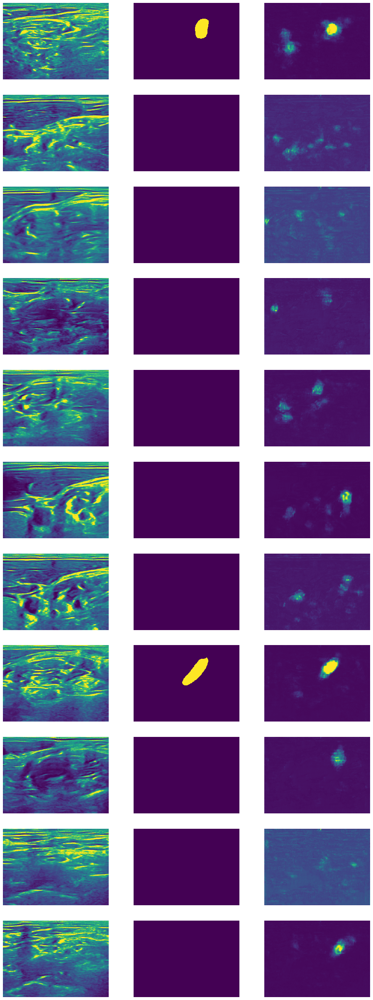


36008 images processed, loss = 0.17429558533880085
Validation loss = 0.1961737642715656
Dice score = 0.48255471931398797

37000 images processed, loss = 0.17158099910758792
Validation loss = 0.17013797179699053
Dice score = 0.5862361800473374

38008 images processed, loss = 0.1662189012745429
Validation loss = 0.19016718127593654
Dice score = 0.48541513016139637

39000 images processed, loss = 0.16166976864812307
Validation loss = 0.16714025815061853
Dice score = 0.5720768969302058

40000 images processed, loss = 0.1593898488351054
Validation loss = 0.17853120610470574
Dice score = 0.4634470663428798

After 8 epochs: loss = 0.0
Validation loss = 0.1785312066297954
Dice score = 0.4634470663428799


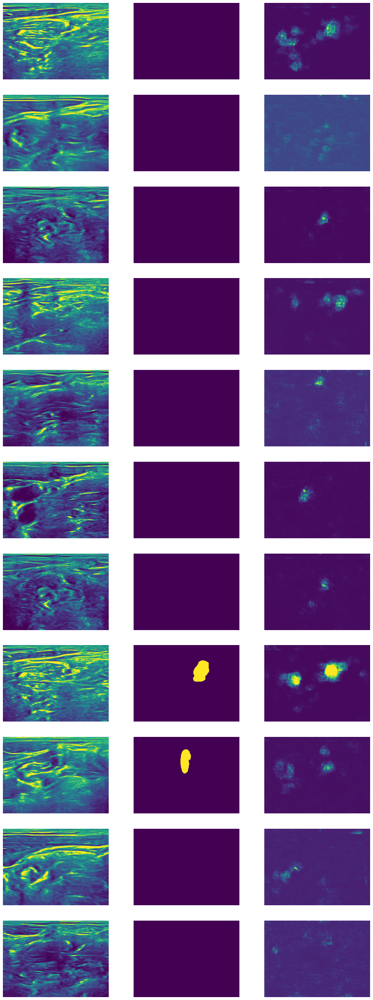


41008 images processed, loss = 0.1532065182767738
Validation loss = 0.164672965602301
Dice score = 0.5831072798028075

42000 images processed, loss = 0.14685720853842632
Validation loss = 0.19273829578122734
Dice score = 0.39353912891395243

43008 images processed, loss = 0.14471120594373035
Validation loss = 0.15617495105483606
Dice score = 0.5117224027810767

44000 images processed, loss = 0.14594250218397056
Validation loss = 0.1707655042114493
Dice score = 0.5149024603679566

45000 images processed, loss = 0.14145284113611928
Validation loss = 0.14535475148016494
Dice score = 0.5606946226722739

After 9 epochs: loss = 0.0
Validation loss = 0.14535475171696752
Dice score = 0.5606946226722739


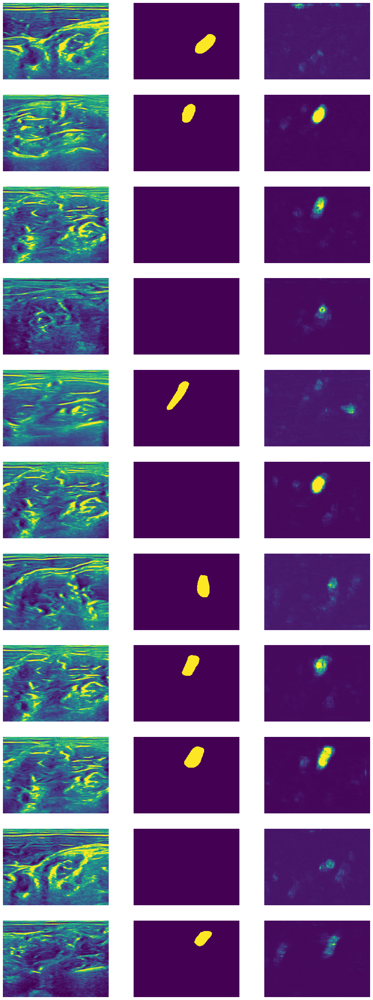


46008 images processed, loss = 0.13265198129505265
Validation loss = 0.15334090760845595
Dice score = 0.477960125386282

47000 images processed, loss = 0.12849714801363155
Validation loss = 0.16479116670068486
Dice score = 0.4604368606521208

48008 images processed, loss = 0.12617633981527196
Validation loss = 0.1440268248596498
Dice score = 0.5241170432063684

49000 images processed, loss = 0.13379832605630063
Validation loss = 0.13807509266536616
Dice score = 0.5673077842911451

50000 images processed, loss = 0.13473651280845297
Validation loss = 0.42201010437784653
Dice score = 0.22353393141018102

After 10 epochs: loss = 0.0
Validation loss = 0.4220101028929984
Dice score = 0.22353393141018096


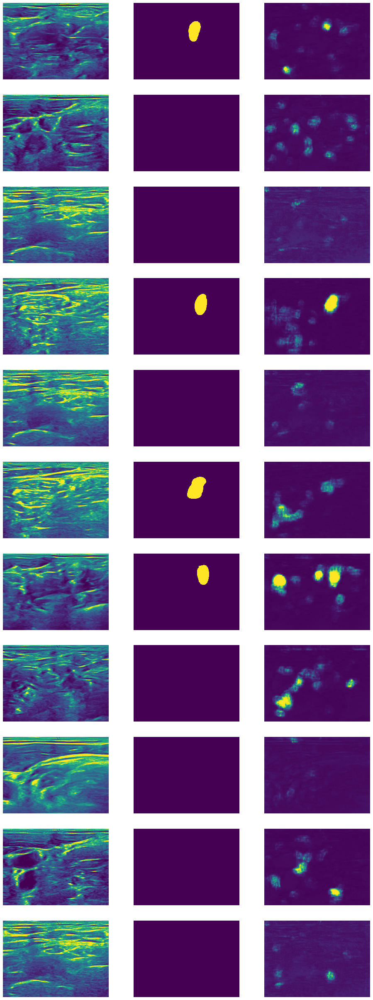


51008 images processed, loss = 0.13189849720437355
Validation loss = 0.12962727065982188
Dice score = 0.5357871310745544

52000 images processed, loss = 0.11952243263737226
Validation loss = 0.1396777341247778
Dice score = 0.5172653825760325

53008 images processed, loss = 0.11661853955404472
Validation loss = 0.14018185573697067
Dice score = 0.3808807062208952

54000 images processed, loss = 0.11607528156420786
Validation loss = 0.11640112093774328
Dice score = 0.5515574022998682

55000 images processed, loss = 0.11011320625579948
Validation loss = 0.1381053027166323
Dice score = 0.4700818697820114

After 11 epochs: loss = 0.0
Validation loss = 0.13810530180254654
Dice score = 0.4700818697820115


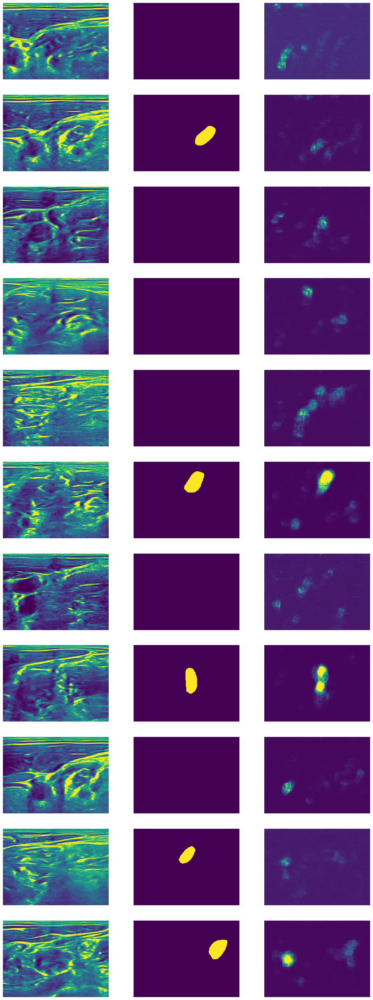


56008 images processed, loss = 0.10659970929366674
Validation loss = 0.13281699632423213
Dice score = 0.42509674379111195

57000 images processed, loss = 0.1030040344908798
Validation loss = 0.1185797246230281
Dice score = 0.46670910506426905

58008 images processed, loss = 0.10082341890592142
Validation loss = 0.12375833195228207
Dice score = 0.5315334614309499

59000 images processed, loss = 0.09870474837369282
Validation loss = 0.13002734820805317
Dice score = 0.5658947510713589

60000 images processed, loss = 0.0985383686585704
Validation loss = 0.12989585213761656
Dice score = 0.4978302685186413

After 12 epochs: loss = 0.0
Validation loss = 0.12989585207499482
Dice score = 0.49783026851864143


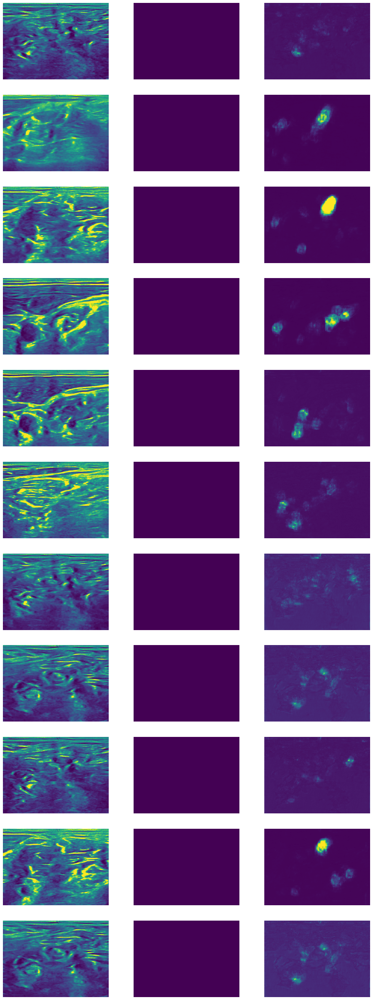


61008 images processed, loss = 0.09533279357130789
Validation loss = 0.1074497790284872
Dice score = 0.5403219580312207

62000 images processed, loss = 0.09230547296226534
Validation loss = 0.12480771555233357
Dice score = 0.5561116776236082

63008 images processed, loss = 0.08753724388677699
Validation loss = 0.10334204912213768
Dice score = 0.5826651914223424

64000 images processed, loss = 0.08536024910750634
Validation loss = 0.10419718501758218
Dice score = 0.5321868948262221

65000 images processed, loss = 0.08514234822221188
Validation loss = 0.09624410760184524
Dice score = 0.6118908419716053

After 13 epochs: loss = 0.0
Validation loss = 0.09624410759685395
Dice score = 0.6118908419716053


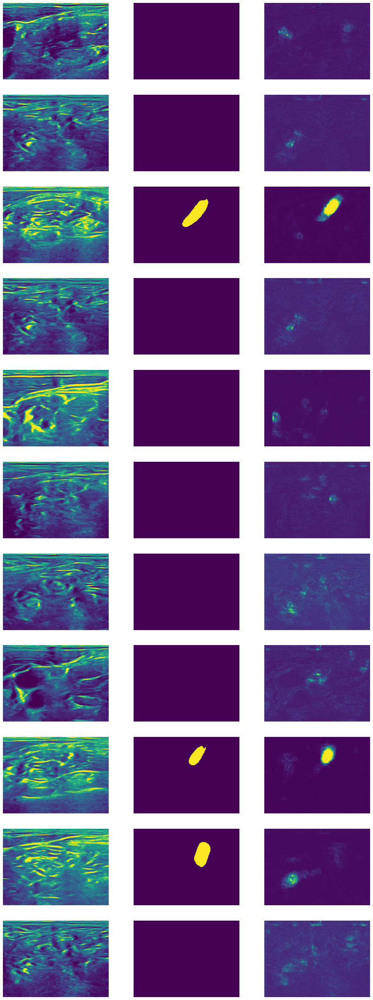


66008 images processed, loss = 0.07946998779688416
Validation loss = 0.10532917246426057
Dice score = 0.5051433081678506

67000 images processed, loss = 0.0783854787025419
Validation loss = 0.09930637208688943
Dice score = 0.43097221845375716

68008 images processed, loss = 0.08168248017005299
Validation loss = 0.09598830727682421
Dice score = 0.5872958545978276

69000 images processed, loss = 0.07702121884827028
Validation loss = 0.10461803983035711
Dice score = 0.5642998419183934

70000 images processed, loss = 0.07672652223113682
Validation loss = 0.10224775624602853
Dice score = 0.5311267976704976

After 14 epochs: loss = 0.0
Validation loss = 0.10224775540513813
Dice score = 0.5311267976704974


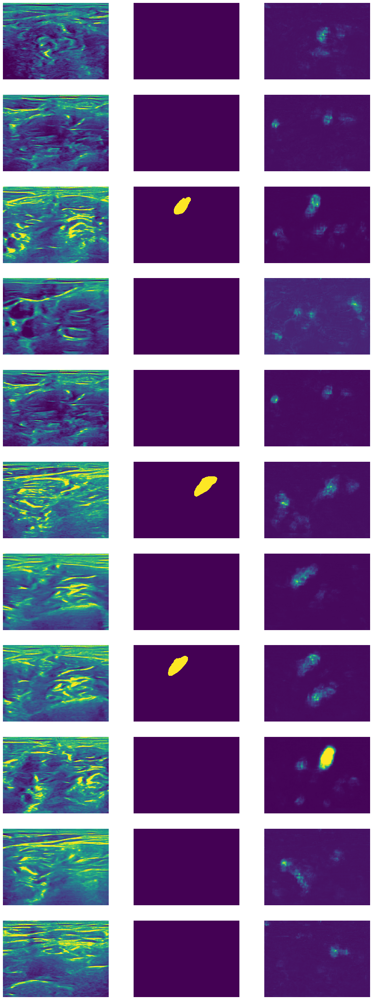


71008 images processed, loss = 0.07394725314838123
Validation loss = 0.08265158348599937
Dice score = 0.5722457019703873

72000 images processed, loss = 0.07134207778146553
Validation loss = 0.10959710281801814
Dice score = 0.5589019214403635

73008 images processed, loss = 0.07355932465732805
Validation loss = 0.09329969359469473
Dice score = 0.6007934246240528

74000 images processed, loss = 0.07540316569761654
Validation loss = 0.08743045418840263
Dice score = 0.5019651486813287

75000 images processed, loss = 0.07154953644755434
Validation loss = 0.09709030267659048
Dice score = 0.46906410448884217

After 15 epochs: loss = 0.0
Validation loss = 0.09709030266000235
Dice score = 0.4690641044888423


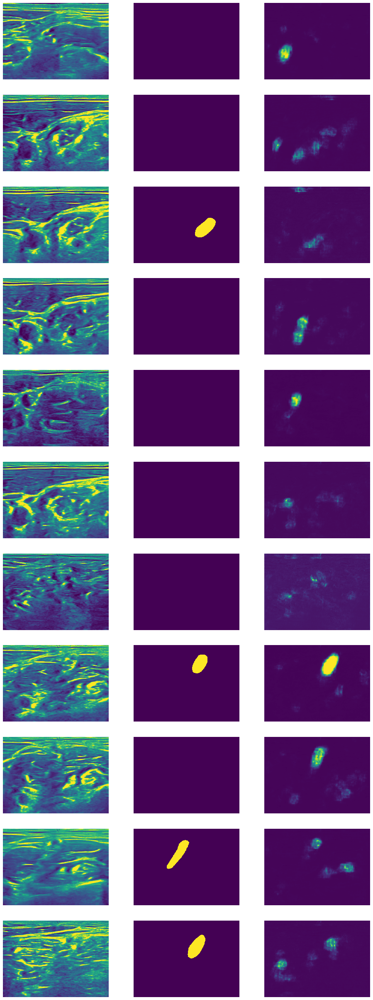


76008 images processed, loss = 0.06624408381138733
Validation loss = 0.08676794921167291
Dice score = 0.5346519206695362

77000 images processed, loss = 0.06342396807666834
Validation loss = 0.08428400406831489
Dice score = 0.5761201435891983

78008 images processed, loss = 0.06203354142964883
Validation loss = 0.07955209903260485
Dice score = 0.5775837454924104

79000 images processed, loss = 0.08556225867037291
Validation loss = 0.07252950015417957
Dice score = 0.6044129455963408

80000 images processed, loss = 0.09092950991096951
Validation loss = 0.07697561057118361
Dice score = 0.572257215816388

After 16 epochs: loss = 0.0
Validation loss = 0.07697561054567538
Dice score = 0.5722572158163881


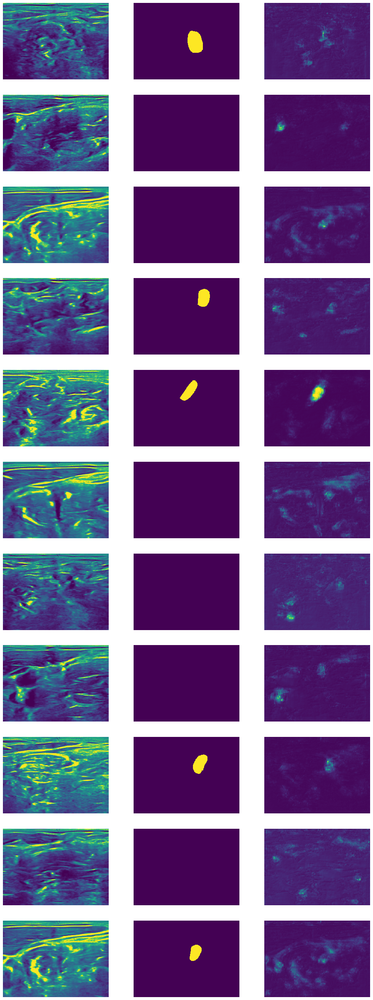


81008 images processed, loss = 0.07449538339396292
Validation loss = 0.0934276571290419
Dice score = 0.36473631123286976

82000 images processed, loss = 0.06863047229766649
Validation loss = 0.07455594581803224
Dice score = 0.4679141883588435

83008 images processed, loss = 0.07067063085740502
Validation loss = 0.07687195032782446
Dice score = 0.4515566943889722

84000 images processed, loss = 0.06786525872897571
Validation loss = 0.07245077429787565
Dice score = 0.44208453630377265

85000 images processed, loss = 0.06261427099249232
Validation loss = 0.0705030633908974
Dice score = 0.5181815895790931

After 17 epochs: loss = 0.0
Validation loss = 0.07050306338607601
Dice score = 0.5181815895790931


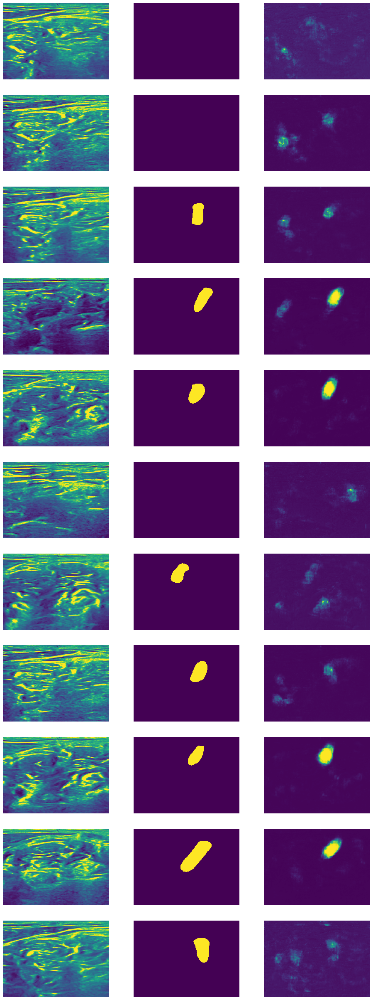


86008 images processed, loss = 0.06043836537577632
Validation loss = 0.07931370749544643
Dice score = 0.36957906106181593

87000 images processed, loss = 0.06183685714115579
Validation loss = 0.07240414262243333
Dice score = 0.5185441858438831

88008 images processed, loss = 0.05689057280009806
Validation loss = 0.07207240501380606
Dice score = 0.468861752625201

89000 images processed, loss = 0.05519041956970303
Validation loss = 0.07097226221133111
Dice score = 0.5000846257206952

90000 images processed, loss = 0.05629538635213513
Validation loss = 0.06326935005824576
Dice score = 0.5611060065915126

After 18 epochs: loss = 0.0
Validation loss = 0.06326935018347264
Dice score = 0.5611060065915127


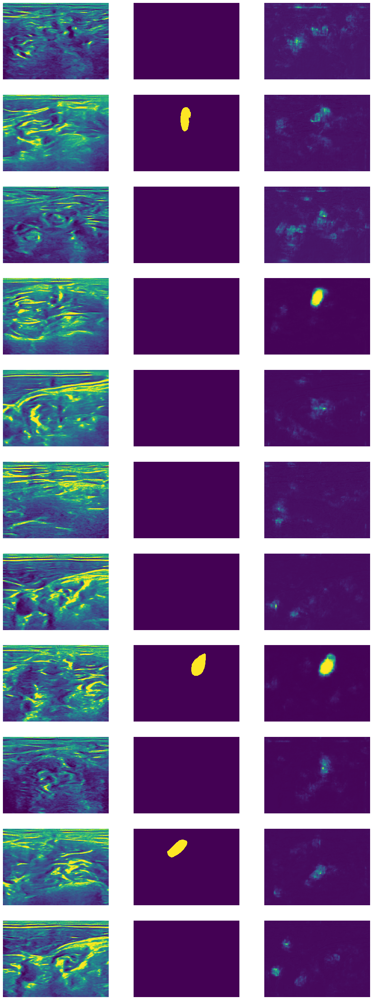


91008 images processed, loss = 0.05265266084766839
Validation loss = 0.06419645755389054
Dice score = 0.5348244848262674

92000 images processed, loss = 0.0525355917741238
Validation loss = 0.06640513152606108
Dice score = 0.47144476006053343

93008 images processed, loss = 0.05075260035485764
Validation loss = 0.06555122628419248
Dice score = 0.5281696180576416

94000 images processed, loss = 0.05081778877127505
Validation loss = 0.0715930756889582
Dice score = 0.5082359958649388

95000 images processed, loss = 0.04831552687253261
Validation loss = 0.07580951938756982
Dice score = 0.4913508617081862

After 19 epochs: loss = 0.0
Validation loss = 0.07580951927135576
Dice score = 0.49135086170818637


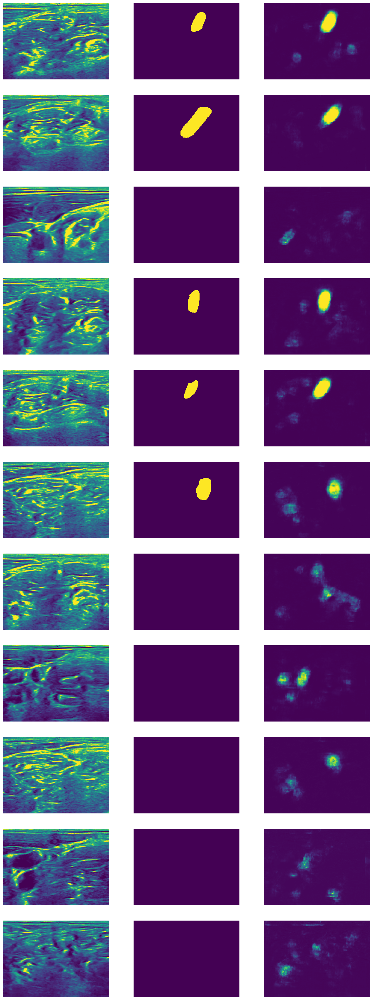


96008 images processed, loss = 0.04568763075635776
Validation loss = 0.07261656053608602
Dice score = 0.5163819493538562

97000 images processed, loss = 0.046658322309145545
Validation loss = 0.07214932085241976
Dice score = 0.530297978930156

98008 images processed, loss = 0.045936944262347776
Validation loss = 0.08247397717785701
Dice score = 0.48466560430936045

99000 images processed, loss = 0.045367520020570505
Validation loss = 0.06929003953623987
Dice score = 0.4721633660118978

100000 images processed, loss = 0.043208844914291285
Validation loss = 0.06425812161796492
Dice score = 0.5876526778253637

After 20 epochs: loss = 0.0
Validation loss = 0.06425812168304068
Dice score = 0.5876526778253636


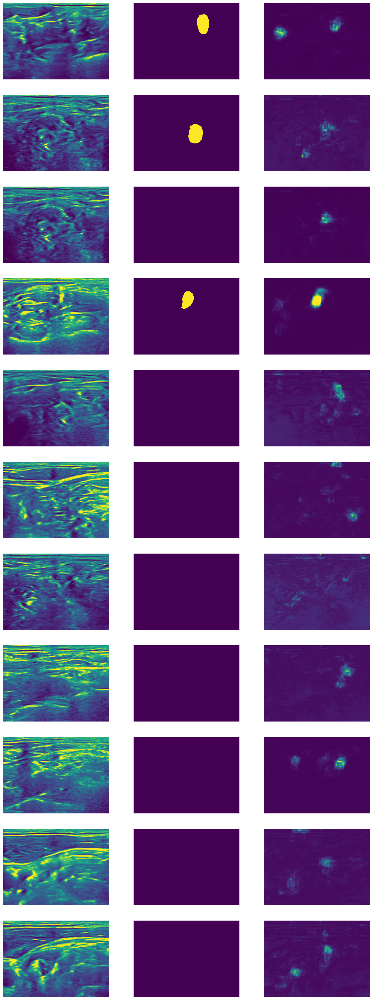


CPU times: user 26min 1s, sys: 2min 17s, total: 28min 19s
Wall time: 25min 25s


In [10]:
%%time

params_train = {
    'epochs': 20,
    'print_every': 1000,
    'lr': 0.0001
}

detector.fit(loader_train_full, loader_val_full, **params_train)

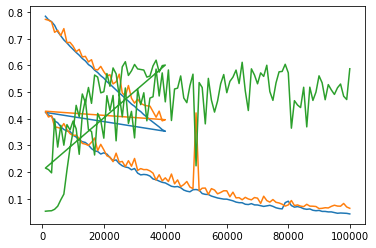

In [11]:
plt.plot(detector.n_samples, detector.loss_history,
         detector.n_samples, detector.val_loss_history,
         detector.n_samples, detector.dice_history)

In [23]:
torch.save(detector.model.state_dict(),
           os.path.join(MODEL_PATH, 'unet_filters8_epochs20.pth'))

## Training binary classifier: if the nerve exists on image

In [62]:
sqznet = models.squeezenet1_1()
sqznet.to(device)

SqueezeNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (3): Fire(
      (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (4): Fire(
      (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (5): MaxPool2d

In [ ]:
%%time

detector.fit_binary(loader_train_full, loader_val_full, epochs=10, print_every=1000, lr=0.001)

1008 images processed, loss = 0.6809782073611305
Validation loss = 0.6482561598612567

2000 images processed, loss = 0.6106550506045741
Validation loss = 0.6371324556080376

3008 images processed, loss = 0.5810465647114648
Validation loss = 0.6172790684099273

4000 images processed, loss = 0.5630791278616074
Validation loss = 0.5700935860318461

5000 images processed, loss = 0.536707513332367
Validation loss = 0.5801309982622702

After 1 epochs: loss = 0.0
Validation loss = 0.5801310016414312

6008 images processed, loss = 0.49601699955879697
Validation loss = 0.5570188582882167

7000 images processed, loss = 0.5339168300551753
Validation loss = 0.6035007572549534

8008 images processed, loss = 0.5301505549559518
Validation loss = 0.5586234381349068

9000 images processed, loss = 0.5000964946323826
Validation loss = 0.5479109597018385

10000 images processed, loss = 0.5003032128810883
Validation loss = 0.6184192924987613

After 2 epochs: loss = 0.0
Validation loss = 0.6184192865852296


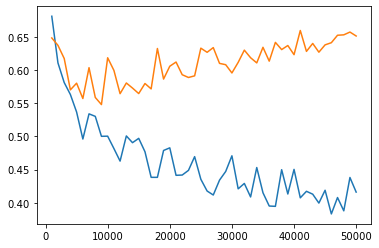

In [13]:
plt.plot(detector.n_samples_bin, detector.loss_history_bin,
         detector.n_samples_bin, detector.val_loss_history_bin)

In [21]:
x, y = next(iter(loader_val_full))

In [22]:
x = torch.cat([x, x, x], dim=1)
o = sqznet(x.to(device))

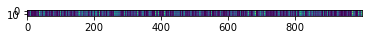

In [26]:
plt.imshow(o.detach().cpu().numpy())

In [28]:
sqznet

SqueezeNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (3): Fire(
      (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (4): Fire(
      (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (5): MaxPool2d

In [63]:
sqznet.features[0] = nn.Conv2d(1, 64, kernel_size=(3, 3), stride=2)

sqznet.features

Sequential(
  (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 2))
  (1): ReLU(inplace=True)
  (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
  (3): Fire(
    (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
    (squeeze_activation): ReLU(inplace=True)
    (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
    (expand1x1_activation): ReLU(inplace=True)
    (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (expand3x3_activation): ReLU(inplace=True)
  )
  (4): Fire(
    (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
    (squeeze_activation): ReLU(inplace=True)
    (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
    (expand1x1_activation): ReLU(inplace=True)
    (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (expand3x3_activation): ReLU(inplace=True)
  )
  (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
 

In [64]:
sqznet.classifier = nn.Sequential(nn.Dropout(p=0.5, inplace=False),
                             nn.Conv2d(512, 2, kernel_size=(1, 1), stride=1),
                             nn.ReLU(inplace=True),
                             nn.AdaptiveAvgPool2d(output_size=(1, 1)))

In [65]:
sqznet.to(device)

SqueezeNet(
  (features): Sequential(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (3): Fire(
      (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (4): Fire(
      (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (5): MaxPool2d

In [66]:
def val_loss(model, dataloader):
    """
    Check accuracy of the model on validation dataset
    """
    model.eval()
    nn = 0
    loss = 0
    with torch.no_grad():
        for x, y in dataloader:
            batch_size = y.shape[0]
            x = x.to(device=device)
            y = y.to(device=device)
            
            y = y.flatten(start_dim=1).bool().any(dim=-1).long()
            
            scores = model(x)
            loss += batch_size * F.cross_entropy(scores, y).item()
            nn += batch_size
        
        loss = loss / nn
        print(f'Validation loss = {loss}')
        
    return loss

def train(model, optimizer, dataloader, dataloader_val, epochs=1, print_every=1000):
    """
    Train a model with optimizer using data provided by dataloader.
        model: PyTorch nn.Module
        optimiser: Pytorch torch.optim with tuned learning hyperparameters
        dataloader: torch.utils.data.DataLoader
        epochs: number of epochs to train
        print_every: Print loss and check accuracy every print_every iterations
    """
    running_loss = 0
    nn = 0
    loss_history = []
    val_loss_history = []
    dice_history = []
    for ee in range(epochs):
        for t, (x, y) in enumerate(dataloader):
            model.train()
            x = x.to(device=device)
            y = y.to(device=device)
            
            y = y.flatten(start_dim=1).bool().any(dim=-1).long()
            
            scores = model(x)
            loss = F.cross_entropy(scores, y)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item()
            nn += 1
            
            if t % print_every == 0:
                loss_history.append(running_loss / nn)
                print(f'Iteration {t}, loss = {loss_history[-1]}')
                vloss = val_loss(model, dataloader_val)
                val_loss_history.append(vloss)
                running_loss, nn = 0, 0
                print()
        print(f'After {ee+1} epochs: loss = {running_loss / max(nn, 1e-6)}')
        val_loss(model, dataloader_val)
        print()

In [67]:
optimizer = optim.Adam(sqznet.parameters(), lr=0.00001)

train(sqznet, optimizer, loader_train_full, loader_val_full, epochs=10, print_every=100)

Iteration 0, loss = 0.7070204019546509
Validation loss = 0.6805730924831601

Iteration 100, loss = 0.6852498680353165
Validation loss = 0.6819282791745944

Iteration 200, loss = 0.6846852397918701
Validation loss = 0.6682162776706726

Iteration 300, loss = 0.6811927437782288
Validation loss = 0.6575474565423379

After 1 epochs: loss = 0.6554909547170004
Validation loss = 0.6459737408818222

Iteration 0, loss = 0.6579403923108027
Validation loss = 0.6453636733565743

Iteration 100, loss = 0.6853402179479599
Validation loss = 0.6523239288743087

Iteration 200, loss = 0.6740403777360916
Validation loss = 0.6410613349103552

Iteration 300, loss = 0.6826081937551498
Validation loss = 0.6525255953233073

After 2 epochs: loss = 0.6471667190392812
Validation loss = 0.6293868598036879

Iteration 0, loss = 0.6449378132820129
Validation loss = 0.6271042937368858

Iteration 100, loss = 0.6779698646068573
Validation loss = 0.6475260334690724

Iteration 200, loss = 0.6707291793823242
Validation loss

In [66]:
y = y.to(device)

In [34]:
y.unique()

tensor([0., 1.], dtype=torch.float64)

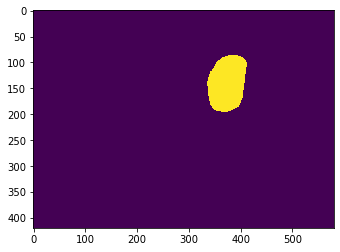

In [70]:
plt.imshow(y.cpu()[3, 0, :, :])

In [52]:
torch.cuda.empty_cache()

In [55]:
s = detector.model.bottom_out

In [58]:
b = detector.model_bin(s).squeeze()

In [60]:
b.sigmoid()

tensor([0.4219, 0.4219, 0.4219, 0.4219], device='cuda:0',
       grad_fn=<SigmoidBackward>)

In [24]:
type(detector.model.parameters())

generator

In [ ]:
n_params = 0
for param in unet.parameters():
    n_params += np.prod(param.shape)
n_params

In [69]:
detector.model

NameError: name 'detector' is not defined